# Unsupervised Algorithms Homework

In this homework assignment, you will apply three fundamental machine learning algorithms to famous datasets:
1. **K-Means clustering**: Customer Segmentation with Retail Dataset
2. **Heirarchical clustering**:Wine Dataset Classification

### Instructions

- Implement **at least** one algorithm
- Complete each section carefully
- Add your code where indicated by `# YOUR CODE HERE`
- Provide comments explaining your approach

In [1]:
!pip install openpyxl

In [2]:
# Import required libraries
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import plotly.express as px

# Machine Learning Libraries
from sklearn.preprocessing import StandardScaler, normalize
from sklearn.cluster import KMeans, AgglomerativeClustering
from scipy.cluster.hierarchy import dendrogram, linkage

# Set random seed for reproducibility
np.random.seed(42)

## Part 1: K-Means Clustering - Customer Segmentation

#### Tasks
1. Load and preprocess the dataset
2. Perform feature engineering
3. Apply K-Means clustering
4. Visualize and interpret customer segments

In [3]:
# Load the dataset
retail_data = pd.read_excel('Online Retail.xlsx', engine='openpyxl')
retail_data.head()

,InvoiceNo,StockCode,Description,Quantity,InvoiceDate,UnitPrice,CustomerID,Country
0,536365,85123A,WHITE HANGING HEART T-LIGHT HOLDER,6,2010-12-01 08:26:00,2.55,17850.0,United Kingdom
1,536365,71053,WHITE METAL LANTERN,6,2010-12-01 08:26:00,3.39,17850.0,United Kingdom
2,536365,84406B,CREAM CUPID HEARTS COAT HANGER,8,2010-12-01 08:26:00,2.75,17850.0,United Kingdom
3,536365,84029G,KNITTED UNION FLAG HOT WATER BOTTLE,6,2010-12-01 08:26:00,3.39,17850.0,United Kingdom
4,536365,84029E,RED WOOLLY HOTTIE WHITE HEART.,6,2010-12-01 08:26:00,3.39,17850.0,United Kingdom


In [4]:
# TODO: Data Preprocessing
# 1. Remove rows with missing values
# 2. Remove negative quantities and zero prices
# 3. Use only Quantity and UnitPrice for the clustering

retail_data = retail_data.dropna()
retail_data = retail_data[(retail_data['Quantity'] > 0) & (retail_data['UnitPrice'] > 0)]
X = retail_data[['Quantity', 'UnitPrice']]

print(f"Dataset cleaned: {X.shape[0]} rows remaining")
X.head() 

Dataset cleaned: 397884 rows remaining


,Quantity,UnitPrice
0,6,2.55
1,6,3.39
2,8,2.75
3,6,3.39
4,6,3.39


In [5]:
print(X.describe())

            Quantity      UnitPrice
count  397884.000000  397884.000000
mean       12.988238       3.116488
std       179.331775      22.097877
min         1.000000       0.001000
25%         2.000000       1.250000
50%         6.000000       1.950000
75%        12.000000       3.750000
max     80995.000000    8142.750000


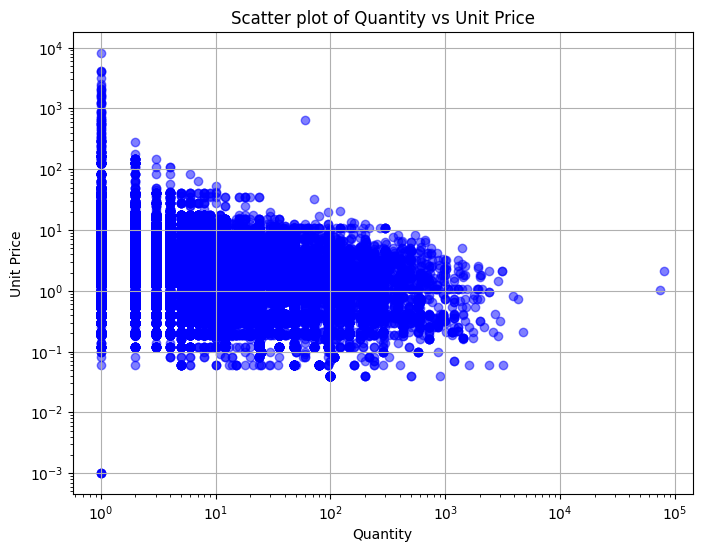

In [6]:
# TODO: Visualise points of dataset

#Matplotlib (Scatter Plot)
plt.figure(figsize=(8, 6))
plt.scatter(X['Quantity'], X['UnitPrice'], alpha=0.5, c='blue')
plt.xlabel('Quantity')
plt.ylabel('Unit Price')
plt.title('Scatter plot of Quantity vs Unit Price')
plt.xscale('log')  # Se i dati sono molto dispersi, puoi usare una scala logaritmica
plt.yscale('log')
plt.grid(True)
plt.show()

#Plotly (Interattivo)
fig = px.scatter(X, x='Quantity', y='UnitPrice', title='Quantity vs Unit Price',
                 labels={'Quantity': 'Quantity', 'UnitPrice': 'Unit Price'}, opacity=0.6)
fig.update_xaxes(type="log")  # Se necessario, imposta la scala logaritmica
fig.update_yaxes(type="log")
fig.show()

            Quantity      UnitPrice
count  397884.000000  397884.000000
mean        1.917715       1.155088
std         1.002350       0.601605
min         0.693147       0.001000
25%         1.098612       0.810930
50%         1.945910       1.081805
75%         2.564949       1.558145
max        11.302155       9.005006


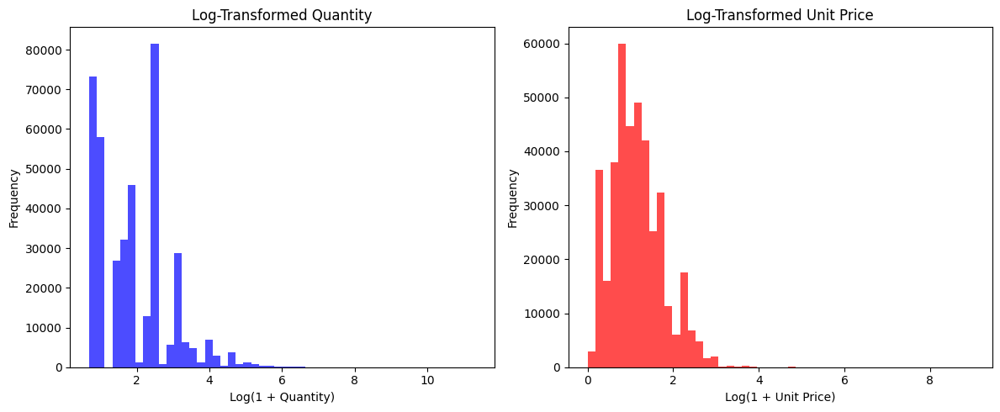

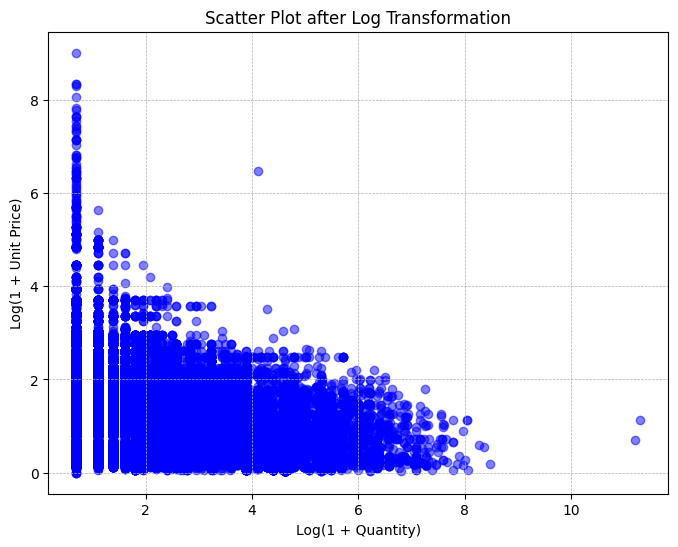

In [7]:
# Applichiamo il log solo se i valori sono > 0
X_log = np.log1p(X)  # log1p(x) = log(1 + x) per gestire eventuali zeri

# Controlliamo le nuove statistiche
print(X_log.describe())

#Visualizzare i dati trasformati 
fig, axes = plt.subplots(1, 2, figsize=(12, 5))

# Istogramma Quantity dopo log
axes[0].hist(X_log['Quantity'], bins=50, color='blue', alpha=0.7)
axes[0].set_title('Log-Transformed Quantity')
axes[0].set_xlabel('Log(1 + Quantity)')
axes[0].set_ylabel('Frequency')

# Istogramma UnitPrice dopo log
axes[1].hist(X_log['UnitPrice'], bins=50, color='red', alpha=0.7)
axes[1].set_title('Log-Transformed Unit Price')
axes[1].set_xlabel('Log(1 + Unit Price)')
axes[1].set_ylabel('Frequency')

plt.tight_layout()
plt.show()

# Scatter Plot con i dati logaritmici 
plt.figure(figsize=(8, 6))
plt.scatter(X_log['Quantity'], X_log['UnitPrice'], alpha=0.5, c='blue')
plt.xlabel('Log(1 + Quantity)')
plt.ylabel('Log(1 + Unit Price)')
plt.title('Scatter Plot after Log Transformation')
plt.grid(True, linestyle="--", linewidth=0.5)
plt.show()

# Plotly interattivo con i dati logaritmici
import plotly.express as px

# Creiamo un DataFrame con i dati trasformati
X_log_df = pd.DataFrame(X_log, columns=['Quantity', 'UnitPrice'])

# Scatter plot interattivo
fig = px.scatter(X_log_df, x='Quantity', y='UnitPrice',
                 title='Scatter Plot after Log Transformation',
                 labels={'Quantity': 'Log(1 + Quantity)', 'UnitPrice': 'Log(1 + Unit Price)'},
                 opacity=0.6)

# Mostriamo il grafico
fig.show()

In [8]:
# TODO: Scale the features

scaler = StandardScaler()
X_log_scaled = scaler.fit_transform(X_log)

In [9]:
# TODO: Perform K-Means Clustering

kmeans = KMeans(n_clusters=4, random_state=42)
kmeans_labels = kmeans.fit_predict(X_log_scaled)

In [10]:
kmeans.cluster_centers_

array([[-0.83202782, -0.46299628],
       [ 1.16778384, -0.79790915],
       [-0.82254022,  1.53034194],
       [ 0.20698234,  0.27476323]])

In [11]:
kmeans_labels

array([3, 3, 3, ..., 3, 3, 2], dtype=int32)

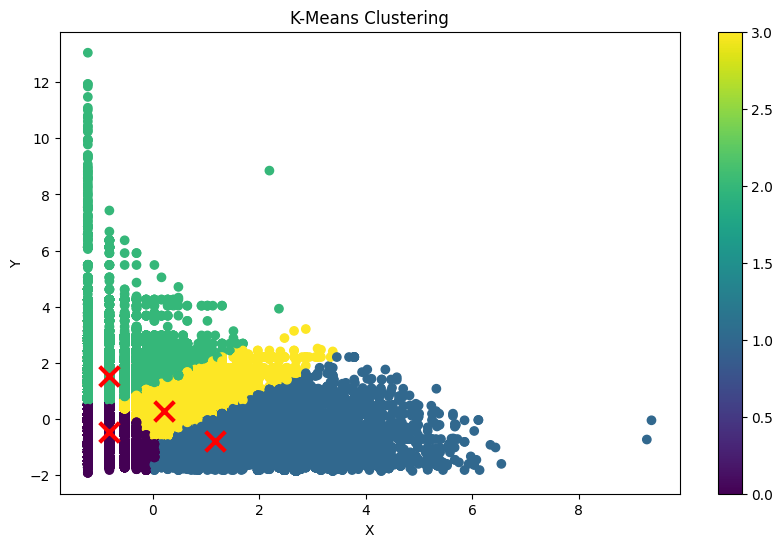

In [12]:
# TODO: Visualise dataset with assign clusters

plt.figure(figsize=(10, 6))
scatter = plt.scatter(X_log_scaled[:, 0], X_log_scaled[:, 1], c=kmeans_labels, cmap='viridis')
plt.scatter(kmeans.cluster_centers_[:, 0], kmeans.cluster_centers_[:, 1], marker='x', color='red', s=200, linewidths=3)
plt.title('K-Means Clustering')
plt.xlabel('X')
plt.ylabel('Y')
plt.colorbar(scatter)
plt.show()

In [13]:
# Confronto con i dati originali
# TODO: Scale the features

scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

In [14]:
# TODO: Perform K-Means Clustering

kmeans = KMeans(n_clusters=4, random_state=42)
kmeans_labels = kmeans.fit_predict(X_scaled)

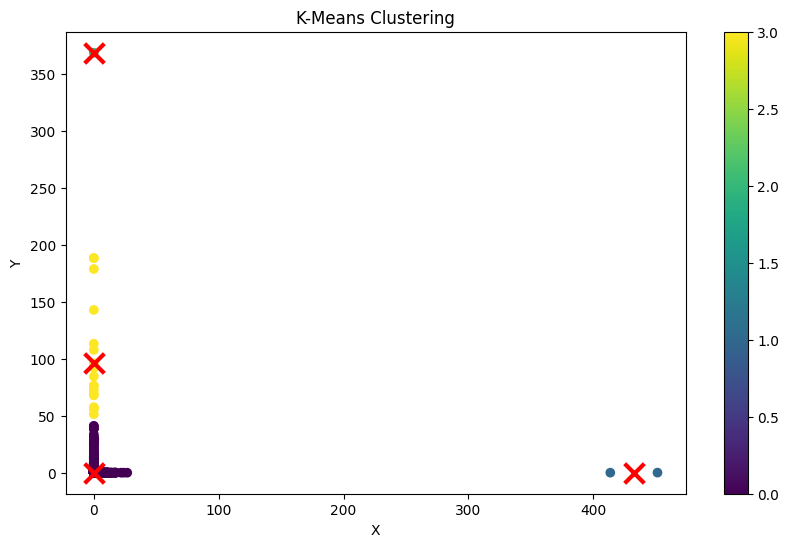

In [15]:
# TODO: Visualise dataset with assign clusters

plt.figure(figsize=(10, 6))
scatter = plt.scatter(X_scaled[:, 0], X_scaled[:, 1], c=kmeans_labels, cmap='viridis')
plt.scatter(kmeans.cluster_centers_[:, 0], kmeans.cluster_centers_[:, 1], marker='x', color='red', s=200, linewidths=3)
plt.title('K-Means Clustering')
plt.xlabel('X')
plt.ylabel('Y')
plt.colorbar(scatter)
plt.show()

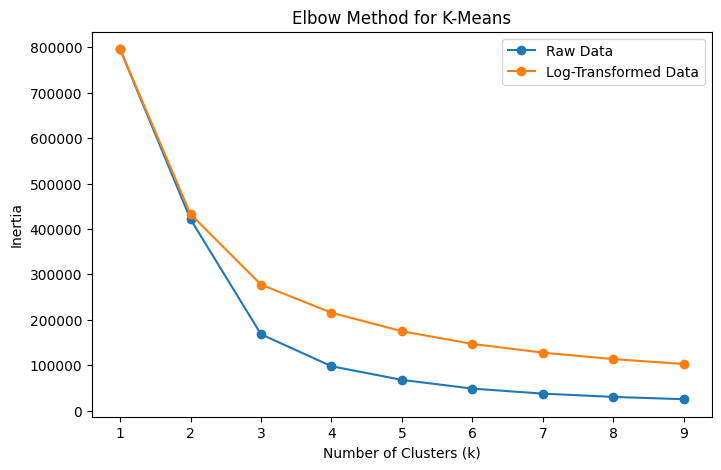

In [16]:
import matplotlib.pyplot as plt

# Numero di cluster da testare
K = range(1, 10)
inertia_raw = []
inertia_log = []

for k in K:
    kmeans_raw = KMeans(n_clusters=k, random_state=42, n_init=10).fit(X_scaled)
    kmeans_log = KMeans(n_clusters=k, random_state=42, n_init=10).fit(X_log_scaled)
    
    inertia_raw.append(kmeans_raw.inertia_)
    inertia_log.append(kmeans_log.inertia_)

# Grafico del Metodo del Gomito
plt.figure(figsize=(8, 5))
plt.plot(K, inertia_raw, marker='o', label='Raw Data')
plt.plot(K, inertia_log, marker='o', label='Log-Transformed Data')
plt.xlabel('Number of Clusters (k)')
plt.ylabel('Inertia')
plt.title('Elbow Method for K-Means')
plt.legend()
plt.show()

Dopo aver eseuito il codice sia sui dati grezzi che sui dati trasformati logaritmicamente, osserviamo che il gomito è simile in entrambi i casi, tuttavia l'inertia più bassa appartiene ai dati grezzi, inoltre il data set grezzo mostra nel grafico cluster più distinti.

## Part 2: Hierarchical Clustering - Wine Dataset Classification

#### Tasks
1. Load Wine dataset
2. Preprocess and scale features
3. Perform Hierarchical Clustering
4. Visualize dendrogram and cluster results

In [17]:
# Load Wine Dataset

from sklearn.datasets import load_wine

wine = load_wine()
X_wine = pd.DataFrame(wine.data, columns=wine.feature_names)

In [18]:
X_wine.describe()

,alcohol,malic_acid,ash,alcalinity_of_ash,magnesium,total_phenols,flavanoids,nonflavanoid_phenols,proanthocyanins,color_intensity,hue,od280/od315_of_diluted_wines,proline
count,178.000000,178.000000,178.000000,178.000000,178.000000,178.000000,178.000000,178.000000,178.000000,178.000000,178.000000,178.000000,178.000000
mean,13.000618,2.336348,2.366517,19.494944,99.741573,2.295112,2.029270,0.361854,1.590899,5.058090,0.957449,2.611685,746.893258
std,0.811827,1.117146,0.274344,3.339564,14.282484,0.625851,0.998859,0.124453,0.572359,2.318286,0.228572,0.709990,314.907474
min,11.030000,0.740000,1.360000,10.600000,70.000000,0.980000,0.340000,0.130000,0.410000,1.280000,0.480000,1.270000,278.000000
25%,12.362500,1.602500,2.210000,17.200000,88.000000,1.742500,1.205000,0.270000,1.250000,3.220000,0.782500,1.937500,500.500000
50%,13.050000,1.865000,2.360000,19.500000,98.000000,2.355000,2.135000,0.340000,1.555000,4.690000,0.965000,2.780000,673.500000
75%,13.677500,3.082500,2.557500,21.500000,107.000000,2.800000,2.875000,0.437500,1.950000,6.200000,1.120000,3.170000,985.000000
max,14.830000,5.800000,3.230000,30.000000,162.000000,3.880000,5.080000,0.660000,3.580000,13.000000,1.710000,4.000000,1680.000000


In [19]:
# TODO: Preprocess the data
# 1. Scale the features using StandardScaler
# 2. Ensure no missing values

scaler = StandardScaler()
X_scaled = scaler.fit_transform(X_wine)
X_wine_cleaned = X_wine.dropna()

In [20]:
# TODO: Compute linkage matrix for Hierarchical Clustering. Use different linkage methods. Try: 'ward', 'complete', 'average'

linkage_matrix1 = linkage(X_wine_cleaned, method='ward')
linkage_matrix2 = linkage(X_wine_cleaned, method='complete')
linkage_matrix3 = linkage(X_wine_cleaned, method='average')

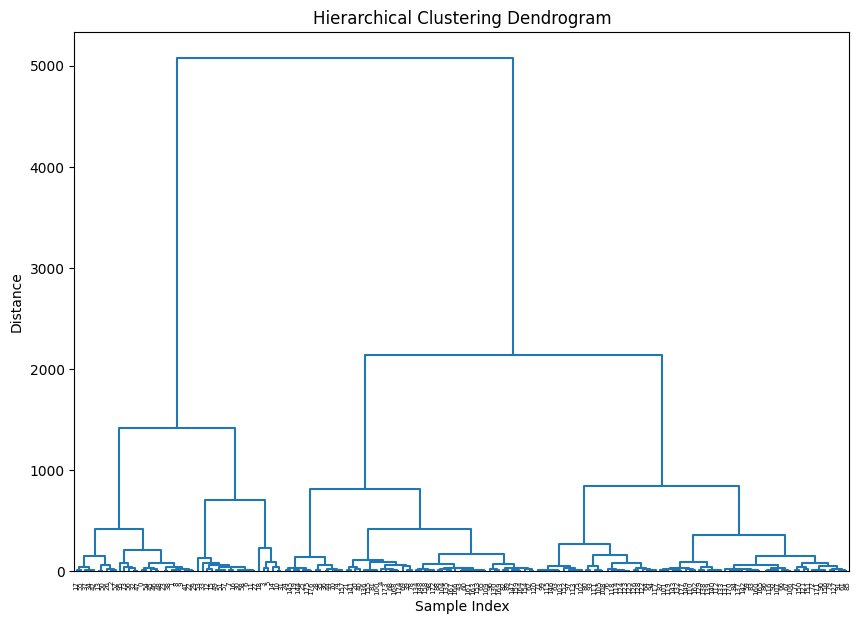

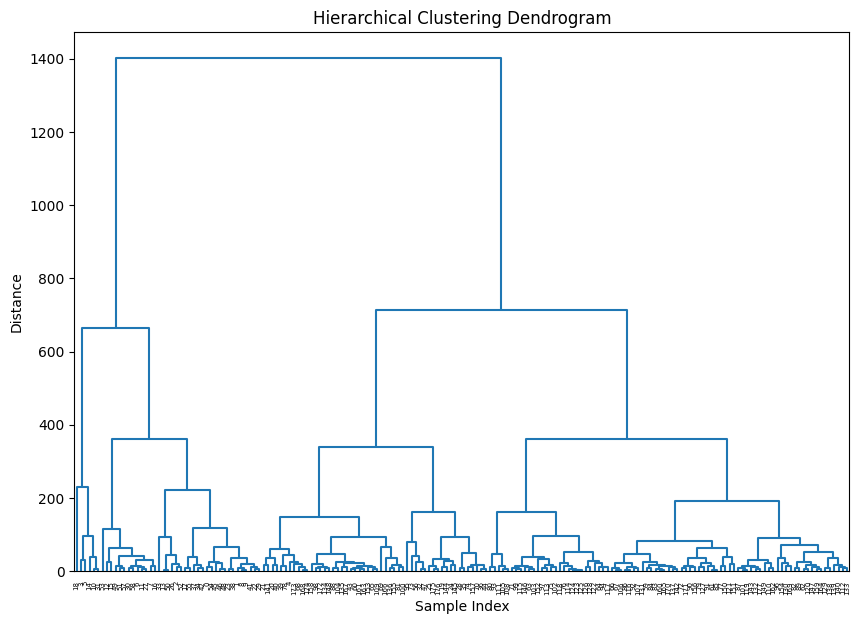

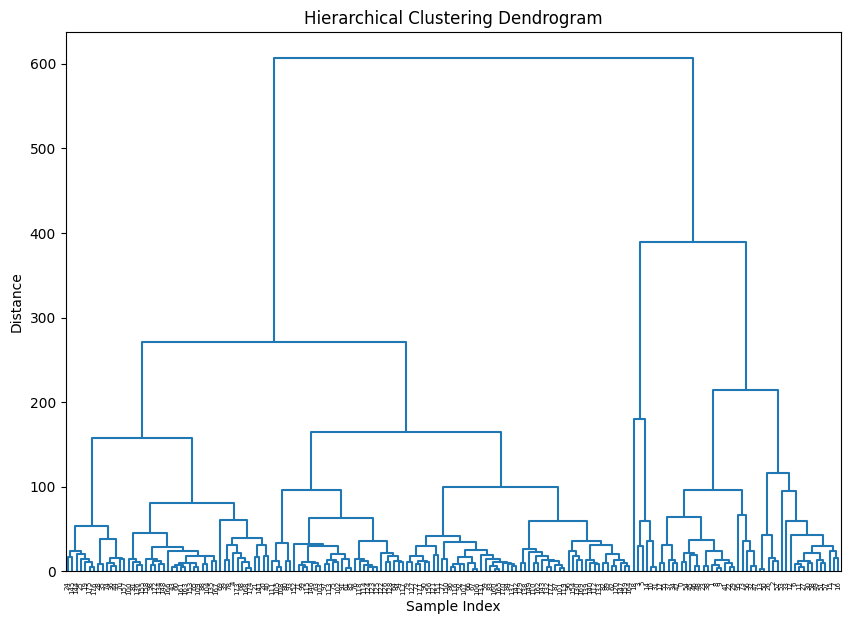

In [21]:
# TODO: Plot dendrogram

plt.figure(figsize=(10, 7))
dendrogram(linkage_matrix1, color_threshold=0)
plt.title('Hierarchical Clustering Dendrogram')
plt.xlabel('Sample Index')
plt.ylabel('Distance')
plt.show()

plt.figure(figsize=(10, 7))
dendrogram(linkage_matrix2, color_threshold=0)
plt.title('Hierarchical Clustering Dendrogram')
plt.xlabel('Sample Index')
plt.ylabel('Distance')
plt.show()

plt.figure(figsize=(10, 7))
dendrogram(linkage_matrix3, color_threshold=0)
plt.title('Hierarchical Clustering Dendrogram')
plt.xlabel('Sample Index')
plt.ylabel('Distance')
plt.show()

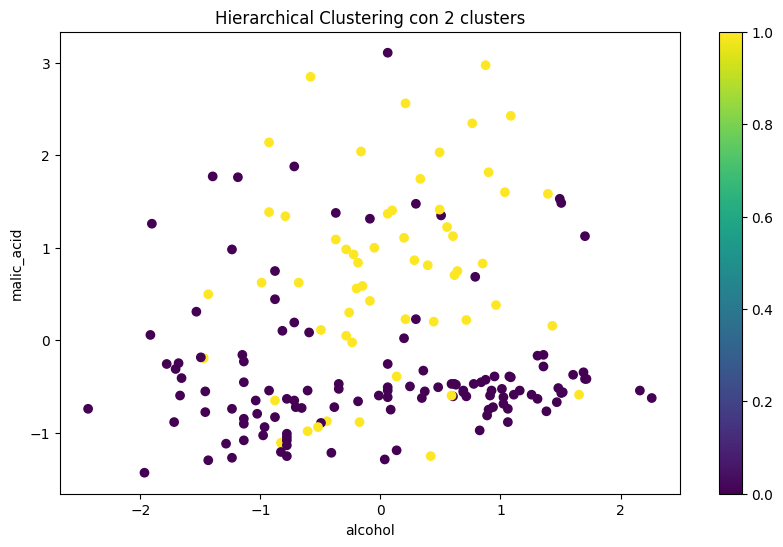

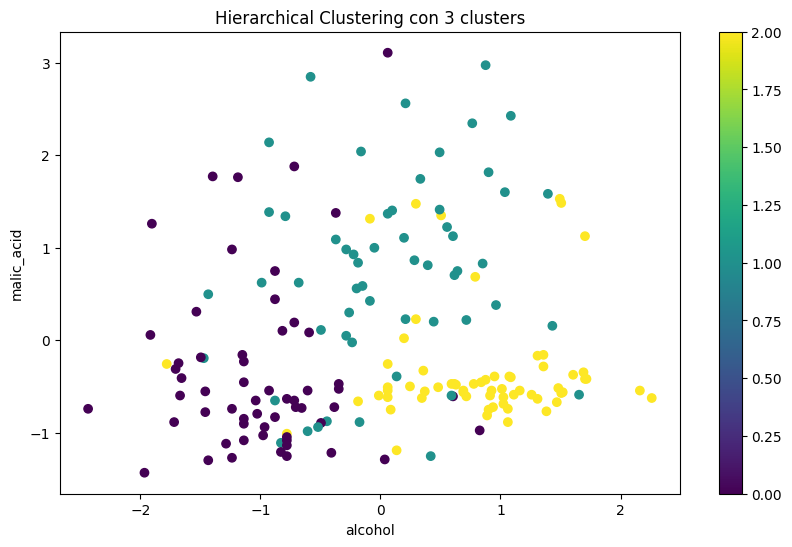

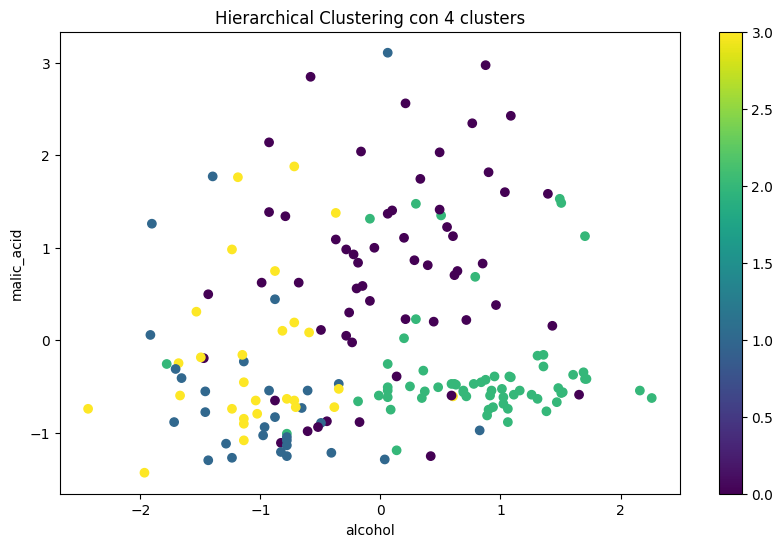

In [22]:
# TODO: Perform Hierarchical Clustering. Try different number of clusters: 2, 3 and 4 clusters. 
# Visualization of Clustering Results on 2 variables on ypur choice.

feature_x = 0  # Prima feature ('alcohol')
feature_y = 1  # Seconda feature ('malic_acid')

for n_clusters in [2, 3, 4]:
    hier_cluster = AgglomerativeClustering(n_clusters=n_clusters)
    hier_labels = hier_cluster.fit_predict(X_scaled)
    
    plt.figure(figsize=(10, 6))
    scatter = plt.scatter(X_scaled[:, feature_x], X_scaled[:, feature_y], c=hier_labels, cmap='viridis')
    plt.title(f'Hierarchical Clustering con {n_clusters} clusters')
    plt.xlabel(wine.feature_names[feature_x])  # Nome della prima feature
    plt.ylabel(wine.feature_names[feature_y])  # Nome della seconda feature
    plt.colorbar(scatter)
    plt.show()

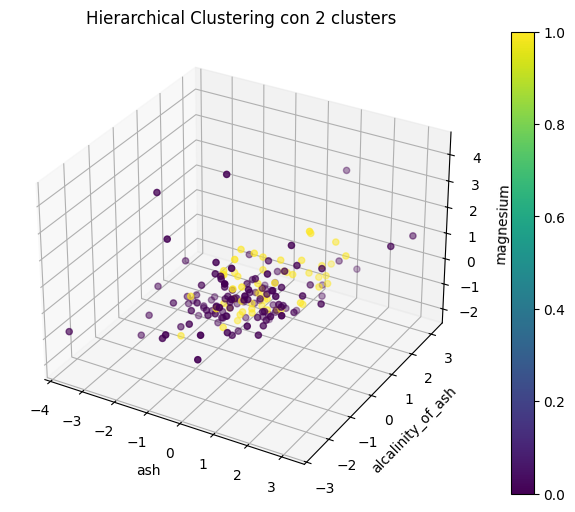

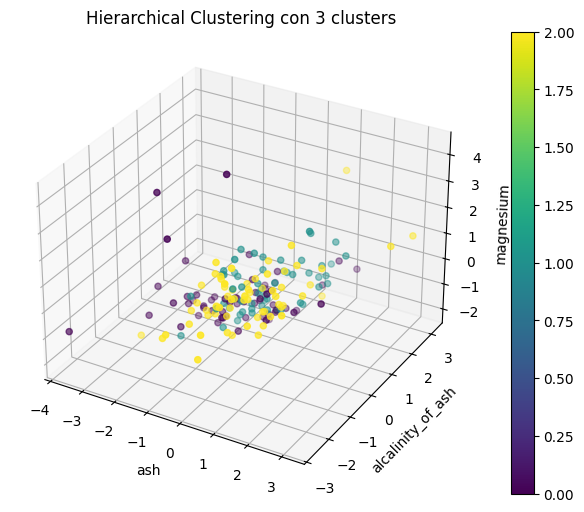

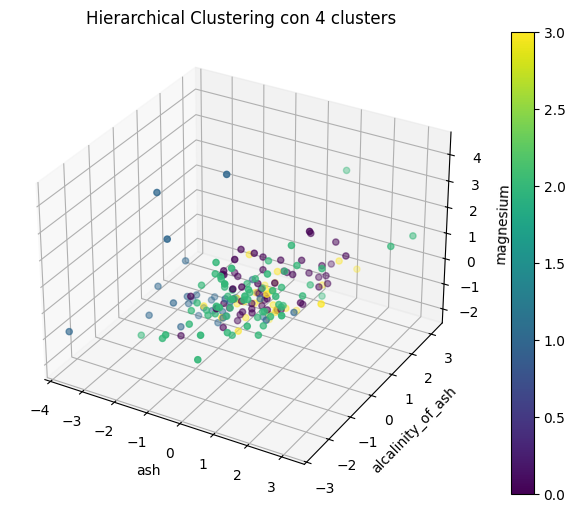

In [23]:
feature_x = 2  # Terza feature ('ash')
feature_y = 3  # Quarta feature ('alcalinity_of_ash')
feature_z = 4  # Quinta feature ('magnesium')

from mpl_toolkits.mplot3d import Axes3D

for n_clusters in [2, 3, 4]:
    hier_cluster = AgglomerativeClustering(n_clusters=n_clusters)
    hier_labels = hier_cluster.fit_predict(X_scaled)
    
    fig = plt.figure(figsize=(10, 6))
    ax = fig.add_subplot(111, projection='3d')
    scatter = ax.scatter(X_scaled[:, feature_x], X_scaled[:, feature_y], X_scaled[:, feature_z], c=hier_labels, cmap='viridis')
    
    ax.set_xlabel(wine.feature_names[feature_x])
    ax.set_ylabel(wine.feature_names[feature_y])
    ax.set_zlabel(wine.feature_names[feature_z])
    plt.title(f'Hierarchical Clustering con {n_clusters} clusters')
    plt.colorbar(scatter)
    plt.show()
